In [1]:
import pandas as pd
import numpy as np
from scipy import stats

In [2]:
sangam_data = pd.read_csv('./Sangam_Data.csv')

In [3]:
sangam_data.head()

,S.no,device_id,latitude,nso,longitude,ewo,svrtime,timestamp,humidity,temperature,...,ch4,h2,c2h5o4,pm01,pm25,pm10,pressure,draft,air_temp,air_speed
0,1,S5,28.4578,N,77.034,E,4/23/2019 19:50,4/19/2023 19:50,41.0,33.2,...,3852370.0,26.62,36.03,62.0,75.0,86.0,0.0,0.0,0.0,0.0
1,2,S3,28.4579,N,77.034,E,4/23/2019 19:50,4/19/2023 19:50,95.0,33.5,...,5163570.0,30.04,39.99,62.0,77.0,92.0,0.0,0.0,0.0,0.0
2,3,S4,28.4579,N,77.034,E,4/23/2019 19:50,4/19/2023 19:50,0.0,0.0,...,2912570.0,23.72,32.62,51.0,67.0,82.0,0.0,0.0,0.0,0.0
3,4,S5,28.4578,N,77.034,E,4/23/2019 19:51,4/19/2023 19:50,41.0,33.3,...,3997190.0,27.03,36.51,63.0,76.0,85.0,0.0,0.0,0.0,0.0
4,5,S3,28.4579,N,77.034,E,4/23/2019 19:51,4/19/2023 19:50,95.0,33.5,...,5258110.0,30.26,40.25,61.0,77.0,95.0,0.0,0.0,0.0,0.0


In [4]:
sangam_data.describe()

,S.no,latitude,longitude,humidity,temperature,heat_index,uv,luminence,ir,accx,...,ch4,h2,c2h5o4,pm01,pm25,pm10,pressure,draft,air_temp,air_speed
count,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,...,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06
mean,5.549364e+05,1.726731e+10,1.896300e+10,5.847379e+01,3.311036e+01,1.054308e+02,2.083207e+00,4.538108e+02,8.141401e+02,-5.230708e+02,...,1.525667e+07,1.858352e+01,2.363607e+01,5.628084e+01,1.492431e+02,1.608585e+02,1.810081e+00,3.853857e+00,9.785538e+00,5.688758e-02
std,3.199438e+05,5.866550e+11,5.956350e+11,2.561486e+01,7.415426e+00,1.918676e+03,3.254922e+01,3.212809e+03,3.538145e+03,2.670664e+03,...,5.249482e+08,3.678936e+01,2.939894e+01,1.623200e+02,3.363523e+02,3.349206e+02,4.300660e+00,7.970380e+00,2.412219e+01,1.377303e+00
min,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-1.964410e+06,0.000000e+00,0.000000e+00,0.000000e+00,-3.276800e+04,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-5.000000e+01,0.000000e+00
25%,2.765865e+05,1.299080e+01,7.703400e+01,3.900000e+01,3.180000e+01,9.615000e+01,2.000000e-02,2.610000e+02,2.530000e+02,0.000000e+00,...,2.241780e+03,1.230000e+00,2.550000e+00,1.300000e+01,1.900000e+01,2.600000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,5.565130e+05,1.310440e+01,7.703400e+01,5.800000e+01,3.330000e+01,1.060000e+02,3.000000e-02,2.620000e+02,2.550000e+02,0.000000e+00,...,2.650140e+06,2.299000e+01,3.154000e+01,2.300000e+01,3.300000e+01,4.300000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,8.344905e+05,2.845800e+01,8.017100e+01,7.840000e+01,3.560000e+01,1.186600e+02,9.000000e-02,2.740000e+02,3.840000e+02,0.000000e+00,...,3.924150e+06,2.703000e+01,3.627000e+01,4.000000e+01,6.300000e+01,8.200000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,1.103661e+06,2.020000e+13,2.020000e+13,1.203200e+03,8.448000e+02,2.645200e+02,6.553500e+02,6.553500e+04,6.553500e+04,3.240800e+04,...,2.820000e+11,2.705830e+03,1.937770e+03,1.200000e+03,1.200000e+03,1.200000e+03,2.480000e+02,1.520000e+02,1.500000e+02,7.500000e+01


In [5]:
sangam_device_groups = sangam_data.groupby(['device_id'])

In [6]:
sangam_device_groups.describe()

S.no                                                      \
                 count          mean            std        min         25%   
device_id                                                                    
M1             13992.0  4.084234e+04   38562.580636     4839.0    19481.25   
M2               696.0  2.327638e+05  142933.696173   130427.0   131486.50   
M3             27048.0  4.279100e+05  243323.582335    24801.0   190789.25   
M4              5558.0  8.630488e+04   44287.643482    42643.0    71217.75   
M5            122410.0  3.998260e+05  194705.153871    28630.0   228275.25   
M6             44437.0  5.673990e+05  111425.200086   195508.0   560098.00   
M7               765.0  4.569141e+05     972.094092   455269.0   456061.00   
S1            201826.0  5.298805e+05  290217.662137     4989.0   299573.25   
S10           119691.0  8.288740e+05  138816.149458   623247.0   699457.00   
S3             77241.0  2.761732e+05  175085.058653        2.0   103419.00   
S4             95594.0  3.014165e+05  217366.396675        3.0   131312.50   
S5            113304.0  2.738366e+05  145491.591666        1.0   150966.25   
S6             15323.0  1.078721e+06   14797.798962  1050876.0  1066611.50   
S7              9835.0  1.088985e+06    8460.941445  1074257.0  1081703.50   
S8            107629.0  9.075917e+05  100339.856996   728971.0   816236.00   
S81                8.0  7.321862e+05      17.252329   732164.0   732172.50   
S9             88382.0  8.923718e+05  109843.147445   730887.0   798617.50   
{"success":1    1912.0  1.067712e+06   14214.382021  1048496.0  1056405.75   

                                                latitude                ...  \
                    50%         75%        max     count          mean  ...   
device_id                                                               ...   
M1              34147.0    56483.25   486426.0   13992.0  1.641467e+10  ...   
M2             132264.0   376574.25   476147.0     696.0  2.263281e+01  ...   
M3             474745.5   623440.75  1007999.0   27048.0  2.040033e+10  ...   
M4              79866.5    93651.00   882404.0    5558.0  2.255452e+10  ...   
M5             461378.5   566314.50   698597.0  122410.0  3.383554e+10  ...   
M6             592585.0   636597.00   695065.0   44437.0  2.796552e+10  ...   
M7             456985.0   457737.00   458571.0     765.0  2.588235e+10  ...   
S1             499368.0   762811.25  1076117.0  201826.0  5.635855e+09  ...   
S10            845618.0   947959.50  1056180.0  119691.0  7.628343e+09  ...   
S3             345891.0   429235.00   549161.0   77241.0  4.553048e+09  ...   
S4             273134.5   401220.00   814739.0   95594.0  3.405653e+09  ...   
S5             283414.0   387382.00   549159.0  113304.0  7.387983e+09  ...   
S6            1078990.0  1091573.50  1103659.0   15323.0  5.433949e+10  ...   
S7            1088932.0  1096292.50  1103661.0    9835.0  1.437722e+10  ...   
S8             916919.0   994318.00  1072943.0  107629.0  3.379585e+10  ...   
S81            732186.5   732200.00   732209.0       8.0  9.815862e+00  ...   
S9             879929.5   952879.50  1103660.0   88382.0  4.094327e+10  ...   
{"success":1  1062856.0  1075267.75  1103607.0    1912.0  0.000000e+00  ...   

             air_temp         air_speed                                     \
                  75%     max     count      mean       std  min  25%  50%   
device_id                                                                    
M1              37.25   48.58   13992.0  0.000000  0.000000  0.0  0.0  0.0   
M2             150.00  150.00     696.0  0.000000  0.000000  0.0  0.0  0.0   
M3             150.00  150.00   27048.0  0.000000  0.000000  0.0  0.0  0.0   
M4             150.00  150.00    5558.0  0.000000  0.000000  0.0  0.0  0.0   
M5              42.13  127.00  122410.0  0.487304  4.004989  0.0  0.0  0.0   
M6              43.99   56.01   44437.0  0.000000  0.000000  0.0  0.0  0.0   
M7             15

In [7]:
devices = sangam_data['device_id'].unique()

In [8]:
devices

array(['S5', 'S3', 'S4', 'M1', 'S1', nan, 'M3', 'M5', 'M4', 'M2', 'M6',
       'M7', 'S10', 'S8', 'S9', 'S81', '{"success":1', 'S6', 'S7'],
      dtype=object)

In [9]:
res = sangam_device_groups['S.no'].unique()

In [10]:
res

device_id
M1              [4839, 4842, 4845, 4849, 4853, 4856, 4859, 486...
M2              [130427, 130432, 130440, 130448, 130453, 13045...
M3              [24801, 24872, 24877, 24881, 24888, 24897, 249...
M4              [42643, 42677, 42691, 42697, 42702, 42706, 427...
M5              [28630, 28678, 28683, 28688, 28692, 28696, 287...
M6              [195508, 195512, 195519, 195525, 195532, 19553...
M7              [455269, 455272, 455274, 455277, 455280, 45528...
S1              [4989, 4994, 5029, 5035, 5040, 5096, 5101, 510...
S10             [623247, 623251, 623256, 623260, 623340, 62334...
S3              [2, 5, 7, 12, 15, 18, 21, 24, 27, 30, 33, 36, ...
S4              [3, 6, 8, 10, 13, 17, 20, 23, 26, 29, 32, 35, ...
S5              [1, 4, 9, 11, 14, 16, 19, 22, 25, 28, 31, 34, ...
S6              [1050876, 1050879, 1050883, 1050887, 1050889, ...
S7              [1074257, 1074262, 1074265, 1074268, 1074270, ...
S8              [728971, 728974, 728978, 728979, 728982, 72898...


In [11]:
for i in res.index:
    print(i+" : "+str(len(res[i])))

M1 : 13992
M2 : 696
M3 : 27048
M4 : 5558
M5 : 122410
M6 : 44437
M7 : 765
S1 : 201826
S10 : 119691
S3 : 77241
S4 : 95594
S5 : 113304
S6 : 15323
S7 : 9835
S8 : 107629
S81 : 8
S9 : 88382
{"success":1 : 1912


In [12]:
device_dict = dict(zip(devices,np.zeros(len(devices))))

In [13]:
device_data_list = [(x) for _,x in sangam_data.groupby(['device_id'])]

In [14]:
device_data_list

[          S.no device_id  latitude nso     longitude ewo         svrtime  \
 4825      4839        M1       0.0   N  0.000000e+00   E  4/24/2019 5:26   
 4828      4842        M1       0.0   N  0.000000e+00   E  4/24/2019 5:27   
 4831      4845        M1       0.0   N  0.000000e+00   E  4/24/2019 5:27   
 4835      4849        M1       0.0   N  0.000000e+00   E  4/24/2019 5:27   
 4839      4853        M1       0.0   N  0.000000e+00   E  4/24/2019 5:28   
 ...        ...       ...       ...  ..           ...  ..             ...   
 460253  486411        M1       0.0   N  2.019050e+09   E  5/25/2019 5:27   
 460255  486413        M1       0.0   N  2.019050e+09   E  5/25/2019 5:28   
 460259  486417        M1       0.0   N  0.000000e+00   E  5/25/2019 5:28   
 460263  486421        M1       0.0   N  0.000000e+00   E  5/25/2019 5:28   
 460268  486426        M1       0.0   N  0.000000e+00   E  5/25/2019 5:28   
 
                   timestamp  humidity  temperature  ...        ch4     h2

In [15]:
for i in device_data_list:
    i['latitude'] = i['latitude'].apply(lambda x: x if int(x)==13 or int(x)==28 else np.nan)
    i['longitude'] = i['longitude'].apply(lambda x: x if int(x)==80 or int(x)==77 else np.nan)

In [16]:
device_data_list

[          S.no device_id  latitude nso  longitude ewo         svrtime  \
 4825      4839        M1       NaN   N        NaN   E  4/24/2019 5:26   
 4828      4842        M1       NaN   N        NaN   E  4/24/2019 5:27   
 4831      4845        M1       NaN   N        NaN   E  4/24/2019 5:27   
 4835      4849        M1       NaN   N        NaN   E  4/24/2019 5:27   
 4839      4853        M1       NaN   N        NaN   E  4/24/2019 5:28   
 ...        ...       ...       ...  ..        ...  ..             ...   
 460253  486411        M1       NaN   N        NaN   E  5/25/2019 5:27   
 460255  486413        M1       NaN   N        NaN   E  5/25/2019 5:28   
 460259  486417        M1       NaN   N        NaN   E  5/25/2019 5:28   
 460263  486421        M1       NaN   N        NaN   E  5/25/2019 5:28   
 460268  486426        M1       NaN   N        NaN   E  5/25/2019 5:28   
 
                   timestamp  humidity  temperature  ...        ch4     h2  \
 4825         4/19/2024 5:26    

In [17]:
def locf_comp(array):
    a = array
    nulllist = []
    last_best = 0
    for i in range(len(a)):
        if(not(np.isnan(a[i]))):
            last_best = a[i]
            if(len(nulllist)>0):
                for j in nulllist:
                    a[j] = a[i]
            nulllist = []
        else:
            nulllist.append(i)
    if(len(nulllist)):
        for j in nulllist:
            a[j] = last_best
    return a


In [18]:
for d in device_data_list:
    d['latitude'] = locf_comp(d['latitude'].values)
    d['longitude'] = locf_comp(d['longitude'].values)

In [19]:
lat_nan = []
long_nan = []
for d in device_data_list:
    lat_nan.append(d['latitude'].isna().sum()!=0)
    long_nan.append(d['longitude'].isna().sum()!=0)
print(np.array(lat_nan).sum())
print(np.array(long_nan).sum())

0
0


In [20]:
device_data_list[0]['latitude'].unique()

array([28.4584, 28.4583, 28.4581, 28.4578, 28.4574, 28.4573, 28.4576,
       28.4577, 28.4579, 28.458 , 28.4575, 28.4582, 28.    , 28.4585,
       28.4572, 28.4571, 28.457 , 28.4564, 28.4569, 28.4568, 28.4566,
       28.4567, 28.4563, 28.4565, 28.4562, 28.4263, 28.4365, 28.44  ,
       28.4438, 28.4427, 28.4526, 28.4451, 28.4352, 28.431 , 28.4286,
       28.4292, 28.4304, 28.4343, 28.4586, 28.4534, 28.4448, 28.4411,
       28.4383, 28.4294, 28.4339, 28.4344, 28.4426, 28.4498, 28.4553,
       28.4587, 28.4561, 28.4468, 28.439 , 28.4351, 28.4412, 28.4421,
       28.4374, 28.443 , 28.4499, 28.4513, 28.4532, 28.4536, 28.4452,
       28.4418, 28.4337, 28.434 , 28.4336, 28.4335, 28.4338, 28.4325,
       28.4341, 28.4334, 28.4333, 28.4342, 28.4346, 28.4345, 28.4318,
       28.4309, 28.433 , 28.436 , 28.4505, 28.4542, 28.4381, 28.4382,
       28.4456, 28.4386, 28.4291, 28.4295, 28.4537, 28.4369, 28.4375,
       28.4296, 28.4289, 28.4439, 28.4423, 28.4317, 28.444 , 28.4397,
       28.437 , 28.4

In [21]:
from datetime import datetime
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns


In [22]:
FMT = "%m/%d/%Y %H:%M"

In [23]:
dt = "4/23/2019 19:50"

In [24]:
svr_time = [datetime.strptime(s,FMT) for s in sangam_data.svrtime.values]

In [25]:
tstmp = []
for i in sangam_data.timestamp:
    if(i!="0000-00-00 00:00:00"):
        tstmp.append(datetime.strptime(i,FMT))
    else:
        tstmp.append(datetime.strptime("1/1/1970 00:00",FMT))

In [26]:
diff = np.array([t - s for t,s in zip(tstmp,svr_time)])

In [27]:
for i in range(len(svr_time)):
    if tstmp[i].year==2019:
        print(tstmp[i].year, diff[i])

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:0

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
201

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:5

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00


2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:5

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 d

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 d

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 d

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00


2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
201

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00


2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:57:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:57:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
201

2019 -1 day, 23:57:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day,

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00


2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 day, 23:57:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:57:00
2019 0:00:00
2019 -1 day, 23:57:00
2019 -1 day, 23:59:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 d

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:0

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:5

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:51:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:51:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:51:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:50:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:50:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:50:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:49:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:49:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:49:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:48:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:48:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:48:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:47:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:47:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
201

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:57:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:57:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:57:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 d

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
20

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00


2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00


2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00


2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00


2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00


2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 d

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 d

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00


2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00


2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:58:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 da

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:

2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:0

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:0

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 

2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00


2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 d

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 da

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:

2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 da

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
20

2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 -1 day

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:0

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
20

2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
20

2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day

2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23:59:00
2019 -1 day, 23:59:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 0:00:00
2019 -1 day, 23

In [28]:
data_cleaned = {}

In [29]:
for d in device_data_list:
    if('S81' not in d['device_id'].unique() and '{"success":1' not in d['device_id'].unique()):
        data_cleaned[d['device_id'].unique()[0]] = (d.drop(['S.no','nso','ewo','timestamp','device_id'],axis=1))

In [30]:
data_cleaned.keys()

dict_keys(['M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'S1', 'S10', 'S3', 'S4', 'S5', 'S6', 'S7', 'S8', 'S9'])

In [31]:
for key in data_cleaned.keys():
    data_cleaned[key]['svrtime'] = pd.to_datetime(data_cleaned[key]['svrtime'])


In [32]:
columns_to_be_cleaned = list(data_cleaned['M1'].columns)

In [33]:
columns_to_be_cleaned.remove('latitude')
columns_to_be_cleaned.remove('longitude')
columns_to_be_cleaned.remove('svrtime')

In [34]:
columns_to_be_cleaned

['humidity',
 'temperature',
 'heat_index',
 'uv',
 'luminence',
 'ir',
 'accx',
 'accy',
 'accz',
 'acctemp',
 'gyrox',
 'gyroy',
 'gyroz',
 'so2_tmp',
 'so2_gas',
 'so2_conc',
 'nh3',
 'co',
 'no2',
 'c3h8',
 'c4h10',
 'ch4',
 'h2',
 'c2h5o4',
 'pm01',
 'pm25',
 'pm10',
 'pressure',
 'draft',
 'air_temp',
 'air_speed']

In [34]:
def remove_outlier(df,col,lower,upper):
    low = lower
    high = upper
    quant_df = df.quantile([low, high])
    df = df[(df[col] > quant_df.loc[low,col]) 
    & (df[col] < quant_df.loc[high,col])]
    return df

def percent_diff(n1,n2):
    return (abs(n1-n2)*100/min(n1,n2))
def remove_outlier_new(a):
    b = np.zeros(a.shape)
    for i,data in enumerate(a):
        if(i==0):
            if((percent_diff(a[i],a[i+1])+percent_diff(a[i],a[i+2]))/2>1.2*percent_diff(a[i+1],a[i+2])):
                b[i] = a[i+1]
            else:
                b[i] = a[i]
        elif(i==len(a)-1):
            if((percent_diff(a[i],a[i-1])+percent_diff(a[i],a[i-2]))/2>1.2*percent_diff(a[i-1],a[i-2])):
                b[i] = a[i-1]
            else:
                b[i] = a[i]
        else:
            if((percent_diff(a[i],a[i-1])+percent_diff(a[i],a[i+1]))/2>1.2*percent_diff(a[i-1],a[i+1])):
                b[i] = (a[i+1]+a[i-1])/2
            else:
                b[i] = a[i]
    return b

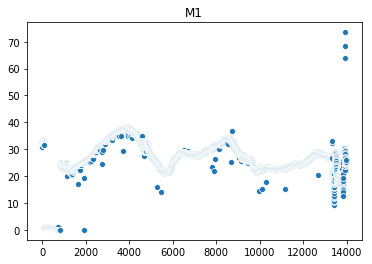

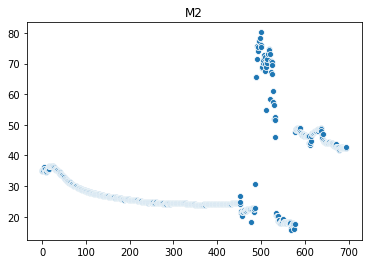

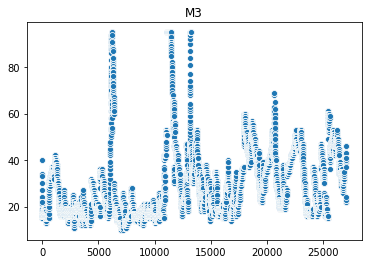

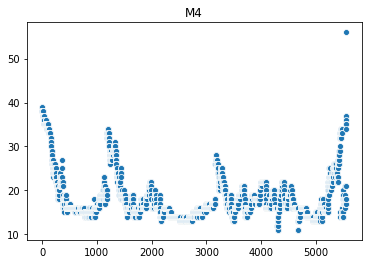

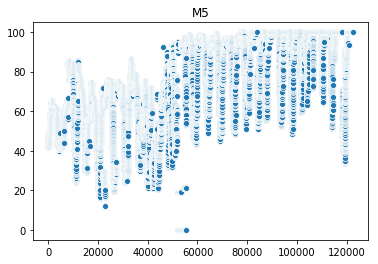

...

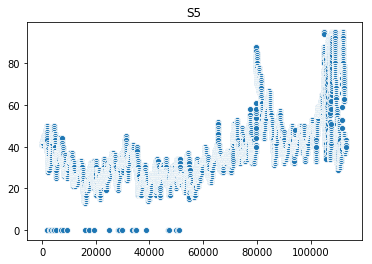

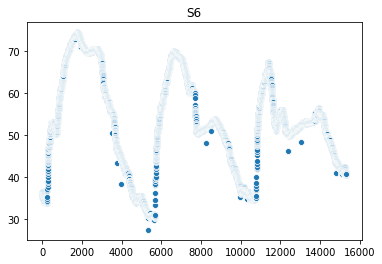

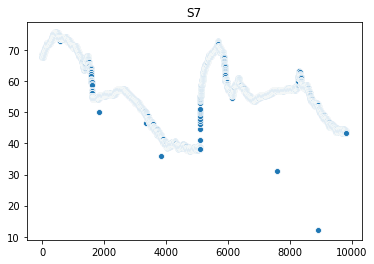

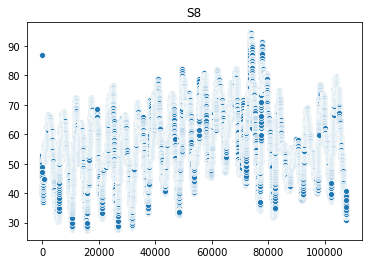

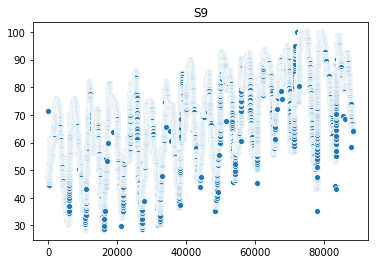

In [76]:

#humidity
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    sns.scatterplot(data = data_cleaned[key]['humidity'].reset_index(drop=True))


In [80]:
#humidity_clean
for key in data_cleaned.keys():
#     plt.figure()
#     plt.title(key)
    d = remove_outlier(data_cleaned[key][data_cleaned[key]['humidity']>10],'humidity',0,0.999)
#     out = pd.DataFrame(d)
    fin = d[['latitude','longitude','svrtime']].copy()
    fin['humidity'] = remove_outlier_new(d['humidity'].values)
    display(fin.head())
    fin.to_csv('./humidity'+key+'.csv')

,latitude,longitude,svrtime,humidity
4825,28.4584,77.033,2019-04-24 05:26:00,32.6
4828,28.4584,77.033,2019-04-24 05:27:00,32.6
4831,28.4584,77.033,2019-04-24 05:27:00,32.5
4835,28.4584,77.033,2019-04-24 05:27:00,32.5
4839,28.4584,77.033,2019-04-24 05:28:00,32.5


,latitude,longitude,svrtime,humidity
122916,28.4567,77.034,2019-04-30 10:04:00,34.9
122921,28.4567,77.034,2019-04-30 10:04:00,34.9
122929,28.4567,77.034,2019-04-30 10:05:00,34.8
122936,28.4567,77.034,2019-04-30 10:05:00,35.3
122941,28.4567,77.034,2019-04-30 10:05:00,35.5


,latitude,longitude,svrtime,humidity
22762,28.459,77.062,2019-04-25 07:46:00,34.0
22827,28.459,77.062,2019-04-25 07:52:00,34.0
22832,28.459,77.062,2019-04-25 07:52:00,33.0
22836,28.459,77.062,2019-04-25 07:52:00,30.0
22843,28.459,77.062,2019-04-25 07:53:00,27.0


,latitude,longitude,svrtime,humidity
39954,28.4575,77.061,2019-04-26 02:55:00,37.0
39960,28.4575,77.061,2019-04-26 02:55:00,37.0
39964,28.4575,77.061,2019-04-26 02:56:00,37.0
39969,28.4575,77.061,2019-04-26 02:56:00,37.0
39975,28.4575,77.061,2019-04-26 02:56:00,37.0


,latitude,longitude,svrtime,humidity
26381,13.0151,80.231,2019-04-25 12:23:00,44.50
26426,13.0151,80.230,2019-04-25 12:26:00,44.50
26431,13.0151,80.230,2019-04-25 12:26:00,44.55
26436,13.0151,80.230,2019-04-25 12:26:00,44.60
26440,13.0151,80.230,2019-04-25 12:27:00,44.70


,latitude,longitude,svrtime,humidity
184265,13.0156,80.200,2019-05-04 13:38:00,71.5
184269,13.0156,80.200,2019-05-04 13:38:00,71.3
184276,13.0156,80.200,2019-05-04 13:38:00,71.0
184282,13.0155,80.199,2019-05-04 13:39:00,71.0
184289,13.0154,80.199,2019-05-04 13:39:00,70.9


,latitude,longitude,svrtime,humidity
431266,0.0,0.0,2019-05-23 10:37:00,56.4
431269,0.0,0.0,2019-05-23 10:38:00,56.4
431271,0.0,0.0,2019-05-23 10:38:00,56.3
431274,0.0,0.0,2019-05-23 10:38:00,56.3
431277,0.0,0.0,2019-05-23 10:38:00,56.4


,latitude,longitude,svrtime,humidity
4969,28.4581,77.033,2019-04-24 05:39:00,89.4
4974,28.4581,77.033,2019-04-24 05:40:00,89.4
5009,28.4581,77.033,2019-04-24 05:42:00,90.0
5015,28.4581,77.033,2019-04-24 05:43:00,90.0
5020,28.4581,77.033,2019-04-24 05:43:00,89.6


,latitude,longitude,svrtime,humidity
586234,13.1067,80.17,2019-06-04 14:58:00,70.40
586238,13.1067,80.17,2019-06-04 14:59:00,70.45
586243,13.1067,80.17,2019-06-04 14:59:00,70.50
586246,13.1067,80.17,2019-06-04 14:59:00,70.50
586324,13.1067,80.17,2019-06-04 15:06:00,69.20


,latitude,longitude,svrtime,humidity
3562,28.458,77.034,2019-04-24 02:54:00,94.0
3568,28.458,77.034,2019-04-24 02:55:00,94.0
3571,28.458,77.034,2019-04-24 02:56:00,94.0
3574,28.458,77.034,2019-04-24 02:56:00,94.0
3580,28.458,77.034,2019-04-24 02:57:00,94.0


,latitude,longitude,svrtime,humidity
5217,28.4580,77.034,2019-04-24 05:59:00,45.0
5220,28.4578,77.034,2019-04-24 05:59:00,45.0
5225,28.4578,77.034,2019-04-24 05:59:00,44.0
5229,28.4578,77.034,2019-04-24 06:00:00,45.0
5233,28.4578,77.034,2019-04-24 06:00:00,45.0


,latitude,longitude,svrtime,humidity
0,28.4578,77.034,2019-04-23 19:50:00,41.0
3,28.4578,77.034,2019-04-23 19:51:00,41.0
8,28.4578,77.034,2019-04-23 19:51:00,41.0
10,28.4578,77.034,2019-04-23 19:51:00,41.0
13,28.4578,77.034,2019-04-23 19:52:00,41.0


,latitude,longitude,svrtime,humidity
995789,13.1092,80.185,2019-07-03 08:40:00,36.4
995792,13.1092,80.185,2019-07-03 08:40:00,36.4
995796,13.1092,80.185,2019-07-03 08:40:00,36.3
995800,13.1092,80.184,2019-07-03 08:41:00,36.0
995802,13.1092,80.184,2019-07-03 08:41:00,36.1


,latitude,longitude,svrtime,humidity
1019170,13.1035,80.172,2019-07-04 13:50:00,68.7
1019175,13.1035,80.172,2019-07-04 13:50:00,68.7
1019178,13.1035,80.172,2019-07-04 13:51:00,68.6
1019181,13.1035,80.172,2019-07-04 13:51:00,68.5
1019183,13.1035,80.172,2019-07-04 13:51:00,68.5


,latitude,longitude,svrtime,humidity
687041,13.0879,80.185,2019-06-13 06:37:00,51.8
687044,13.0879,80.185,2019-06-13 06:37:00,51.8
687047,13.0879,80.185,2019-06-13 06:38:00,51.5
687048,13.0879,80.185,2019-06-13 06:38:00,51.5
687051,13.0879,80.185,2019-06-13 06:38:00,50.9


,latitude,longitude,svrtime,humidity
688861,13.0928,80.18,2019-06-13 10:05:00,46.9
688865,13.0928,80.18,2019-06-13 10:05:00,46.9
688868,13.0928,80.18,2019-06-13 10:05:00,47.0
688871,13.0928,80.18,2019-06-13 10:05:00,47.2
688873,13.0928,80.18,2019-06-13 10:06:00,47.2


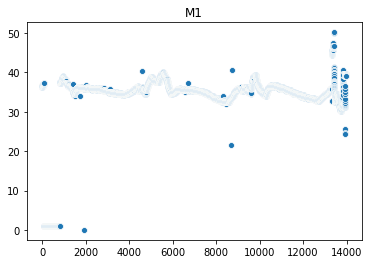

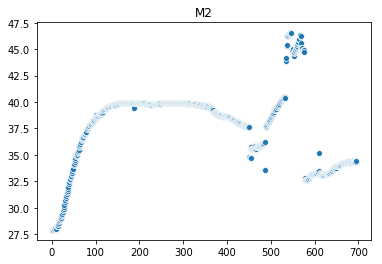

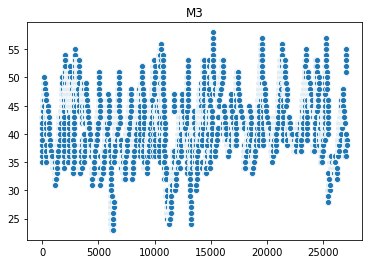

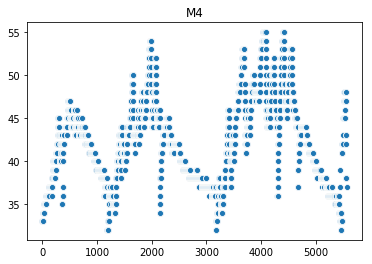

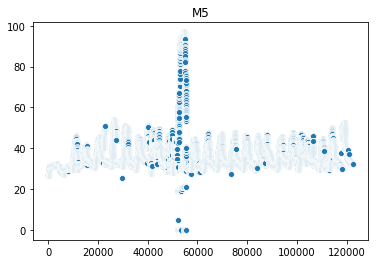

...

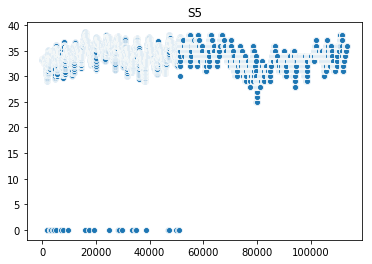

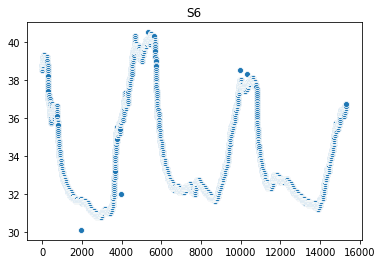

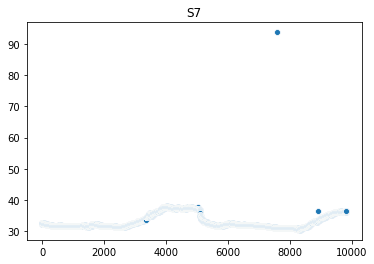

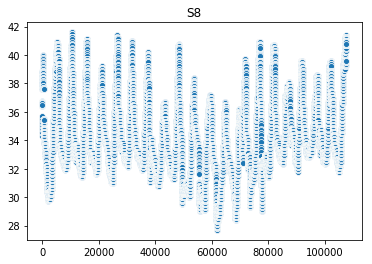

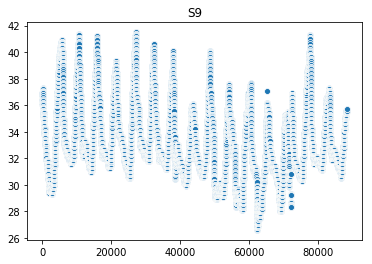

In [125]:
#temperature
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    sns.scatterplot(data = data_cleaned[key]['temperature'].reset_index(drop=True))
#should not use temp for s4

In [88]:
#temperature
for key in data_cleaned.keys():
#     plt.figure()
#     plt.title(key)
    d = remove_outlier(data_cleaned[key][data_cleaned[key]['temperature']>10],'temperature',0,0.999)
#     out = pd.DataFrame(d)
    fin = d[['latitude','longitude','svrtime']].copy()
    fin['temperature'] = remove_outlier_new(d['temperature'].values)
    display(fin.head())
    fin.reset_index(drop=True).to_csv('./temperature'+key+'.csv')

,latitude,longitude,svrtime,temperature
4825,28.4584,77.033,2019-04-24 05:26:00,36.3
4828,28.4584,77.033,2019-04-24 05:27:00,36.3
4831,28.4584,77.033,2019-04-24 05:27:00,36.3
4835,28.4584,77.033,2019-04-24 05:27:00,36.3
4839,28.4584,77.033,2019-04-24 05:28:00,36.3


,latitude,longitude,svrtime,temperature
122941,28.4567,77.034,2019-04-30 10:05:00,28.0
122946,28.4567,77.034,2019-04-30 10:06:00,28.0
122953,28.4567,77.034,2019-04-30 10:06:00,28.0
122959,28.4567,77.034,2019-04-30 10:07:00,28.1
122964,28.4567,77.034,2019-04-30 10:07:00,28.1


,latitude,longitude,svrtime,temperature
22762,28.459,77.062,2019-04-25 07:46:00,35.0
22827,28.459,77.062,2019-04-25 07:52:00,35.0
22832,28.459,77.062,2019-04-25 07:52:00,35.0
22836,28.459,77.062,2019-04-25 07:52:00,35.0
22843,28.459,77.062,2019-04-25 07:53:00,36.0


,latitude,longitude,svrtime,temperature
39800,28.4573,77.061,2019-04-26 02:47:00,33.0
39832,28.4575,77.061,2019-04-26 02:49:00,33.0
39845,28.4575,77.061,2019-04-26 02:49:00,33.0
39851,28.4575,77.061,2019-04-26 02:50:00,33.0
39856,28.4575,77.061,2019-04-26 02:50:00,33.0


,latitude,longitude,svrtime,temperature
26381,13.0151,80.231,2019-04-25 12:23:00,26.8
26426,13.0151,80.230,2019-04-25 12:26:00,26.8
26431,13.0151,80.230,2019-04-25 12:26:00,26.8
26436,13.0151,80.230,2019-04-25 12:26:00,26.8
26440,13.0151,80.230,2019-04-25 12:27:00,26.8


,latitude,longitude,svrtime,temperature
184265,13.0156,80.200,2019-05-04 13:38:00,31.7
184269,13.0156,80.200,2019-05-04 13:38:00,31.7
184276,13.0156,80.200,2019-05-04 13:38:00,31.6
184282,13.0155,80.199,2019-05-04 13:39:00,31.6
184289,13.0154,80.199,2019-05-04 13:39:00,31.6


,latitude,longitude,svrtime,temperature
431266,0.0,0.0,2019-05-23 10:37:00,28.8
431269,0.0,0.0,2019-05-23 10:38:00,28.8
431271,0.0,0.0,2019-05-23 10:38:00,28.9
431274,0.0,0.0,2019-05-23 10:38:00,28.9
431277,0.0,0.0,2019-05-23 10:38:00,28.9


,latitude,longitude,svrtime,temperature
4969,28.4581,77.033,2019-04-24 05:39:00,30.7
4974,28.4581,77.033,2019-04-24 05:40:00,30.7
5009,28.4581,77.033,2019-04-24 05:42:00,31.0
5015,28.4581,77.033,2019-04-24 05:43:00,31.0
5020,28.4581,77.033,2019-04-24 05:43:00,31.1


,latitude,longitude,svrtime,temperature
586234,13.1067,80.17,2019-06-04 14:58:00,32.30
586238,13.1067,80.17,2019-06-04 14:59:00,32.30
586243,13.1067,80.17,2019-06-04 14:59:00,32.30
586246,13.1067,80.17,2019-06-04 14:59:00,32.35
586324,13.1067,80.17,2019-06-04 15:06:00,32.40


,latitude,longitude,svrtime,temperature
1,28.4579,77.034,2019-04-23 19:50:00,33.5
4,28.4579,77.034,2019-04-23 19:51:00,33.5
6,28.4579,77.034,2019-04-23 19:51:00,33.5
11,28.4579,77.034,2019-04-23 19:51:00,33.5
14,28.4579,77.034,2019-04-23 19:52:00,33.5


,latitude,longitude,svrtime,temperature
5217,28.4580,77.034,2019-04-24 05:59:00,32.0
5220,28.4578,77.034,2019-04-24 05:59:00,32.0
5225,28.4578,77.034,2019-04-24 05:59:00,32.0
5229,28.4578,77.034,2019-04-24 06:00:00,31.0
5233,28.4578,77.034,2019-04-24 06:00:00,31.0


,latitude,longitude,svrtime,temperature
0,28.4578,77.034,2019-04-23 19:50:00,33.2
3,28.4578,77.034,2019-04-23 19:51:00,33.2
8,28.4578,77.034,2019-04-23 19:51:00,33.2
10,28.4578,77.034,2019-04-23 19:51:00,33.2
13,28.4578,77.034,2019-04-23 19:52:00,33.2


,latitude,longitude,svrtime,temperature
995789,13.1092,80.185,2019-07-03 08:40:00,38.5
995792,13.1092,80.185,2019-07-03 08:40:00,38.5
995796,13.1092,80.185,2019-07-03 08:40:00,38.5
995800,13.1092,80.184,2019-07-03 08:41:00,38.6
995802,13.1092,80.184,2019-07-03 08:41:00,38.6


,latitude,longitude,svrtime,temperature
1019170,13.1035,80.172,2019-07-04 13:50:00,32.3
1019175,13.1035,80.172,2019-07-04 13:50:00,32.3
1019178,13.1035,80.172,2019-07-04 13:51:00,32.3
1019181,13.1035,80.172,2019-07-04 13:51:00,32.3
1019183,13.1035,80.172,2019-07-04 13:51:00,32.3


,latitude,longitude,svrtime,temperature
687041,13.0879,80.185,2019-06-13 06:37:00,34.5
687044,13.0879,80.185,2019-06-13 06:37:00,34.5
687047,13.0879,80.185,2019-06-13 06:38:00,34.6
687048,13.0879,80.185,2019-06-13 06:38:00,34.6
687051,13.0879,80.185,2019-06-13 06:38:00,34.8


,latitude,longitude,svrtime,temperature
688861,13.0928,80.18,2019-06-13 10:05:00,36.7
688865,13.0928,80.18,2019-06-13 10:05:00,36.7
688868,13.0928,80.18,2019-06-13 10:05:00,36.6
688871,13.0928,80.18,2019-06-13 10:05:00,36.6
688873,13.0928,80.18,2019-06-13 10:06:00,36.6


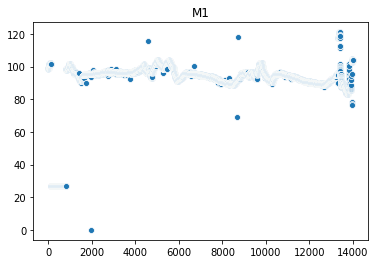

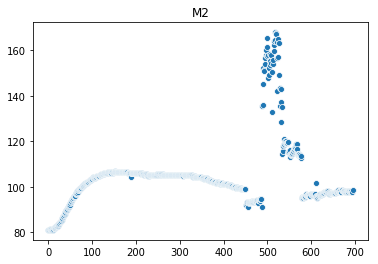

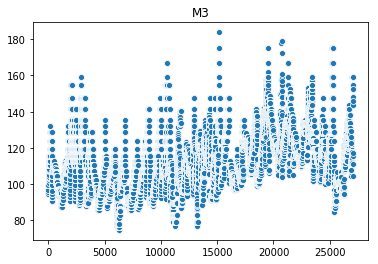

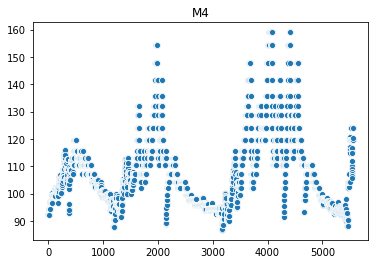

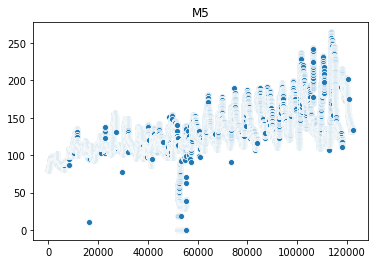

...

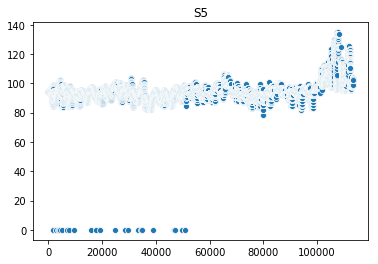

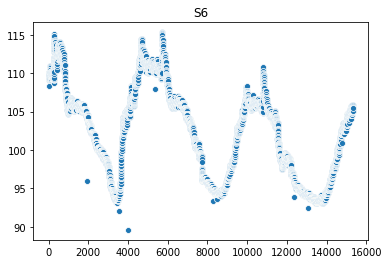

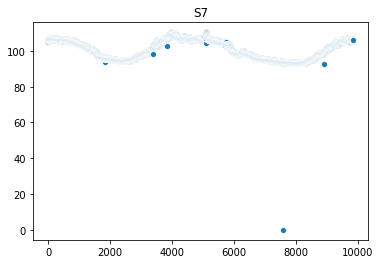

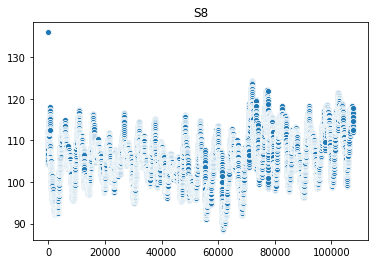

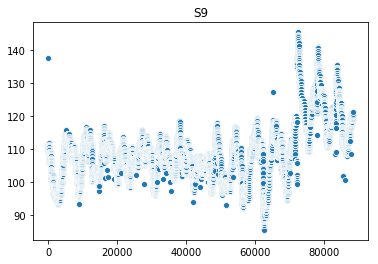

In [84]:
#heat_index
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    sns.scatterplot(data = data_cleaned[key]['heat_index'].reset_index(drop=True))
#s4 dont use heat index

In [89]:
#heat_index_cleaning
for key in data_cleaned.keys():
#     plt.figure()
#     plt.title(key)
    d = remove_outlier(data_cleaned[key][data_cleaned[key]['heat_index']>10],'heat_index',0,0.999)
#     out = pd.DataFrame(d)
    fin = d[['latitude','longitude','svrtime']].copy()
    fin['heat_index'] = remove_outlier_new(d['heat_index'].values)
#     sns.scatterplot(data = fin['heat_index'].values)
#     display(fin.head())
    fin.reset_index(drop=True).to_csv('./heat_index'+key+'.csv')

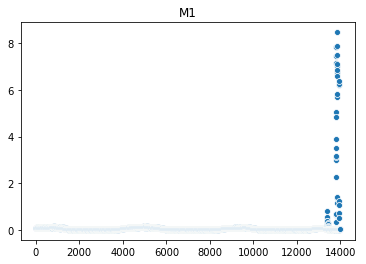

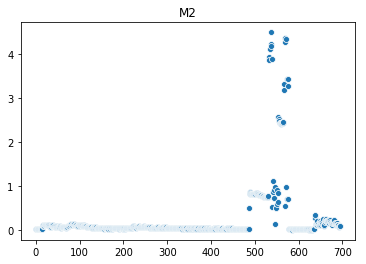

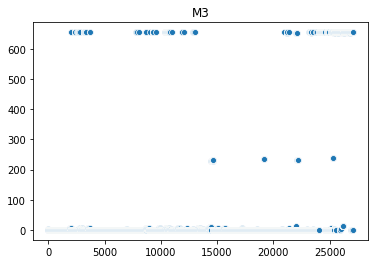

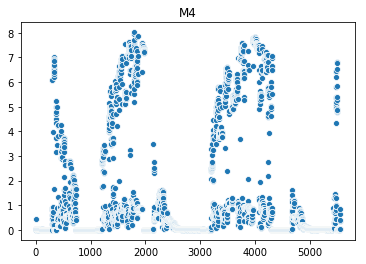

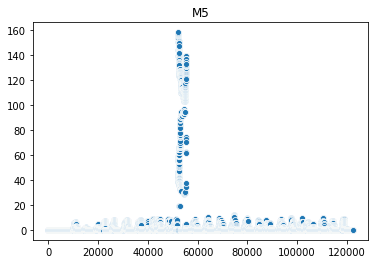

...

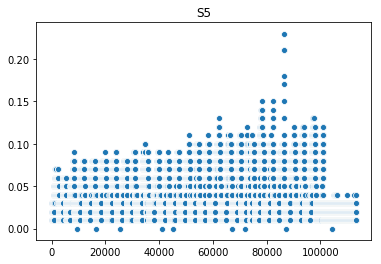

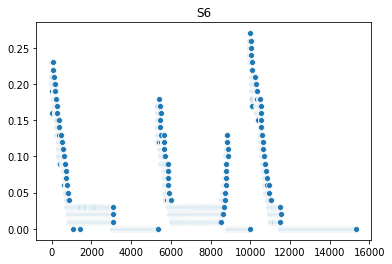

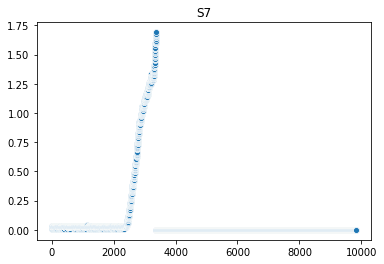

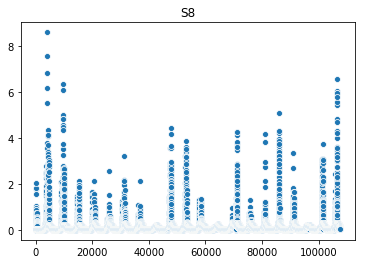

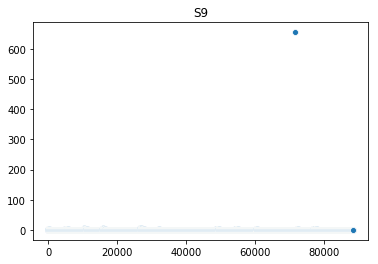

In [90]:
#uv
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    sns.scatterplot(data = data_cleaned[key]['uv'].reset_index(drop=True))
#s4 dont use heat index

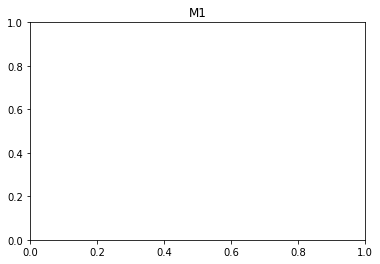

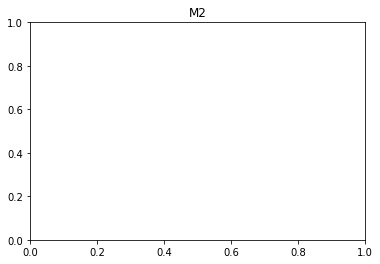

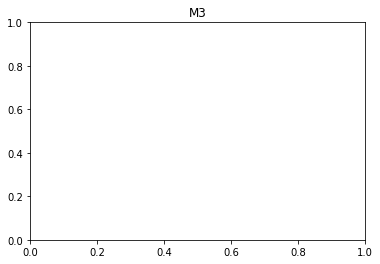

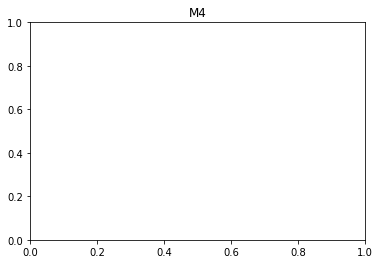

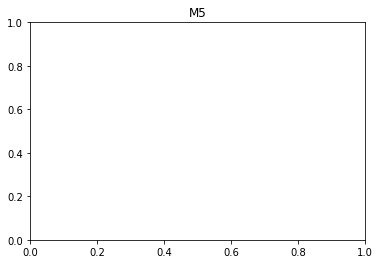

...

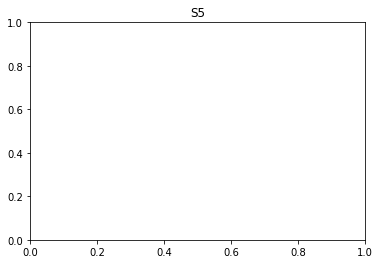

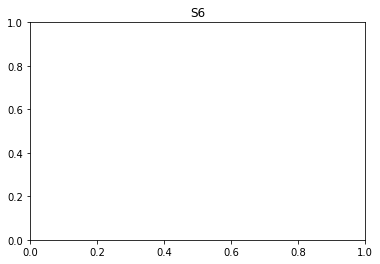

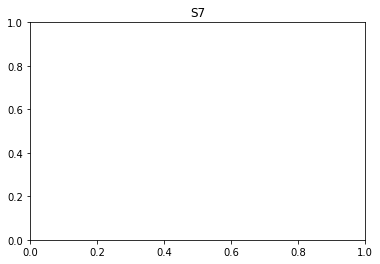

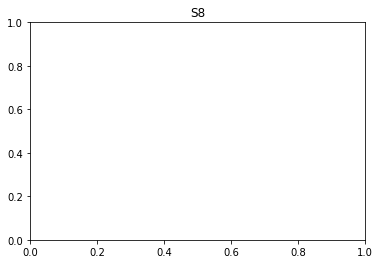

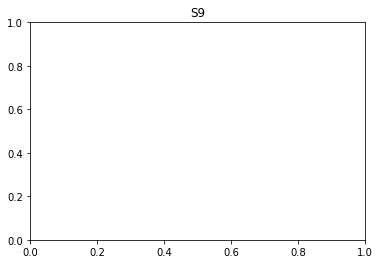

In [101]:
#uv_clean
for key in data_cleaned.keys():
#     plt.figure()
#     plt.title(key)
    d = remove_outlier(data_cleaned[key][data_cleaned[key]['uv']<10],'uv',0.01,0.99)
#     out = pd.DataFrame(d)
    fin = d[['latitude','longitude','svrtime']].copy()
    fin['uv'] = remove_outlier_new(d['uv'].values)
#     sns.scatterplot(data = fin['uv'].values)
#     display(fin.head())
    fin.reset_index(drop=True).to_csv('./uv'+key+'.csv')

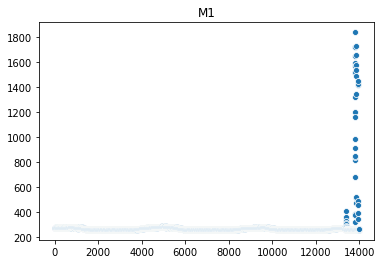

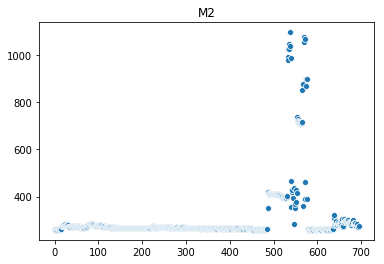

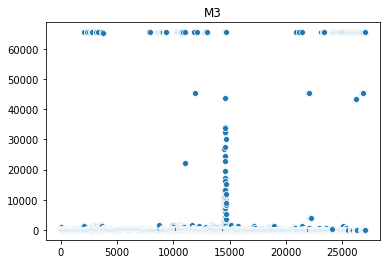

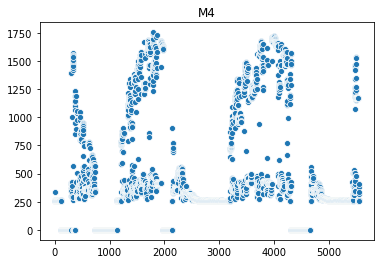

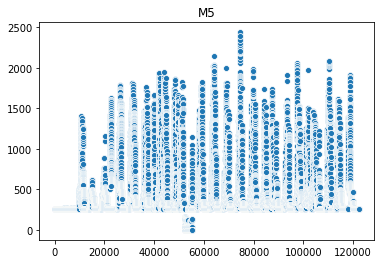

...

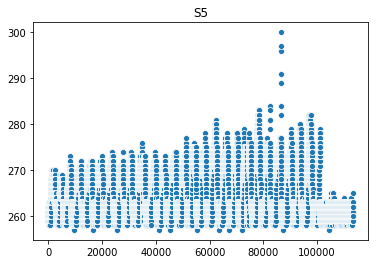

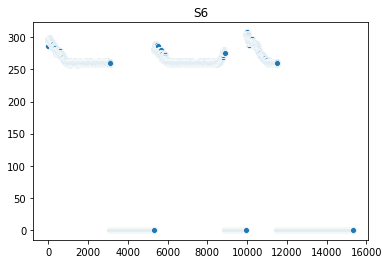

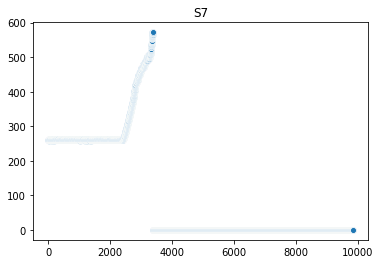

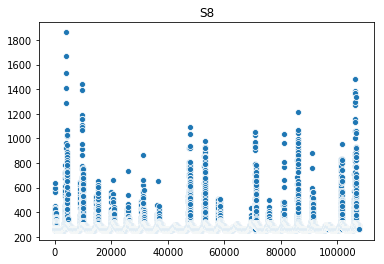

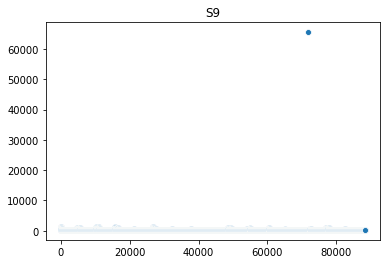

In [102]:
#luminence
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    sns.scatterplot(data = data_cleaned[key]['luminence'].reset_index(drop=True))
#s4 dont use heat index

In [106]:
#luminence_clean
for key in data_cleaned.keys():
#     plt.figure()
#     plt.title(key)
    d = remove_outlier(data_cleaned[key][data_cleaned[key]['luminence']>10],'uv',0,0.7)
#     out = pd.DataFrame(d)
    fin = d[['latitude','longitude','svrtime']].copy()
    fin['luminence'] = remove_outlier_new(d['luminence'].values)
#     sns.scatterplot(data = fin['luminence'].values)
#     display(fin.head())
    fin.reset_index(drop=True).to_csv('./luminence'+key+'.csv')

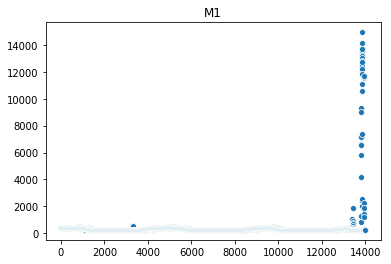

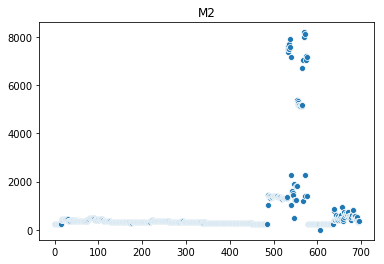

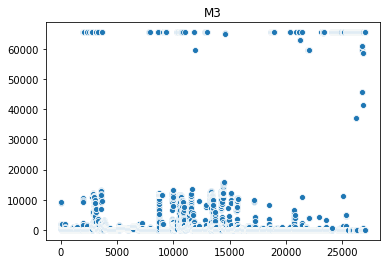

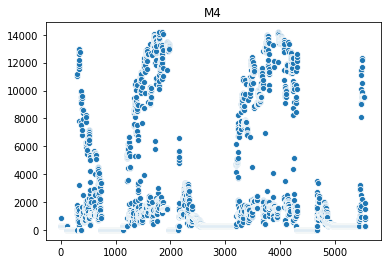

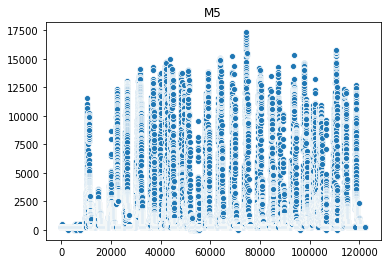

...

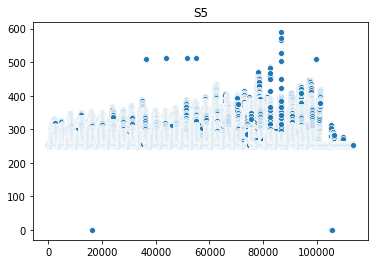

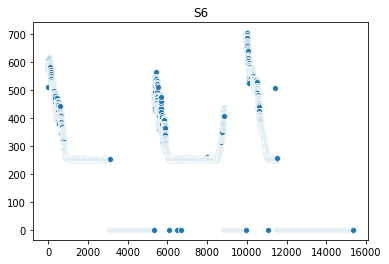

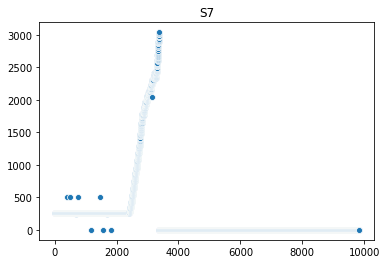

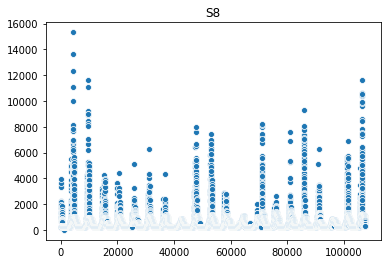

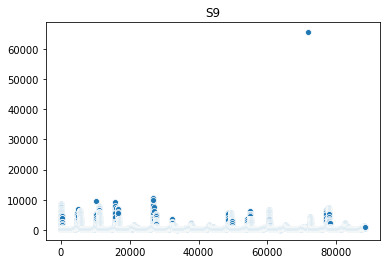

In [107]:
#ir
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    sns.scatterplot(data = data_cleaned[key]['ir'].reset_index(drop=True))
#s4 dont use heat index

In [123]:
#ir_clean
for key in data_cleaned.keys():
#     plt.figure()
#     plt.title(key)
    d = remove_outlier(data_cleaned[key][(data_cleaned[key]['ir']>10) &( data_cleaned[key]['ir']<6000)],'ir',0.1,0.9)
#     out = pd.DataFrame(d)
    fin = d[['latitude','longitude','svrtime']].copy()
    fin['ir'] = remove_outlier_new(d['ir'].values)
#     if(key=='S4'):
#         display(d)
#     sns.scatterplot(data = fin['uv'].values)
#     display(fin.head())
    fin.reset_index(drop=True).to_csv('./ir'+key+'.csv')

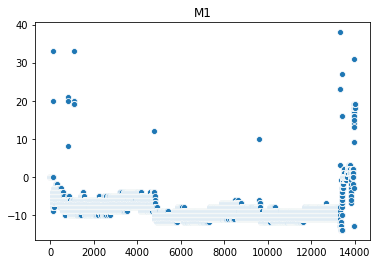

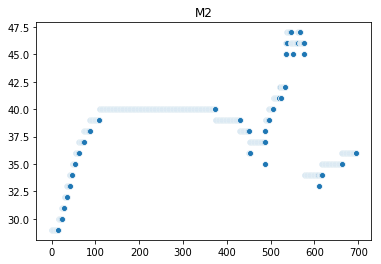

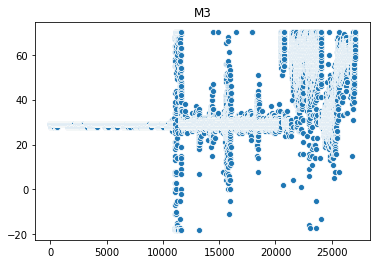

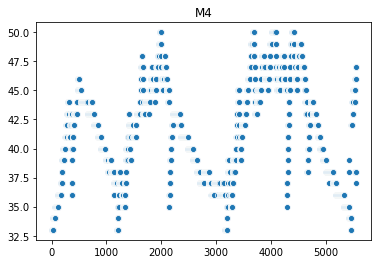

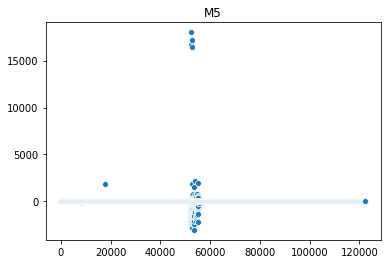

...

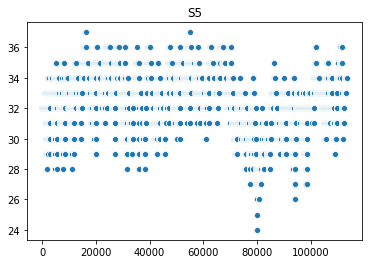

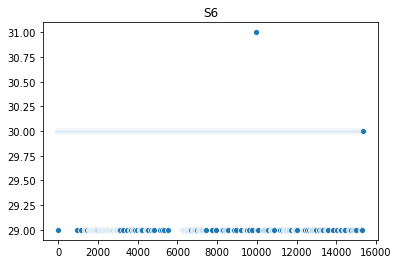

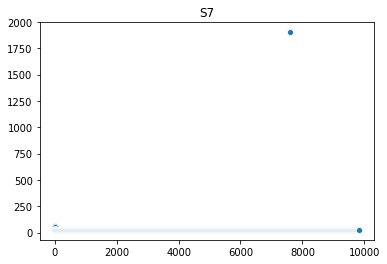

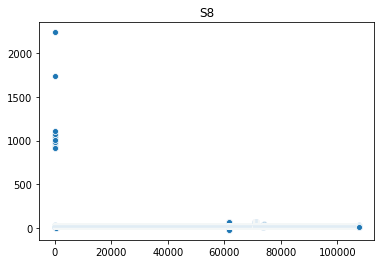

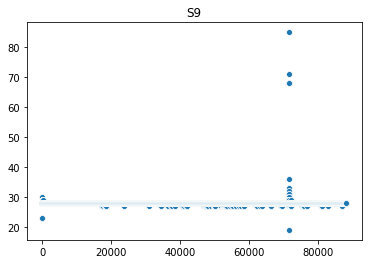

In [124]:
#so2_tmp
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    sns.scatterplot(data = data_cleaned[key]['so2_tmp'].reset_index(drop=True))
#s4 dont use heat index

/home/omshripc/.local/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: divide by zero encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.
/home/omshripc/.local/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.


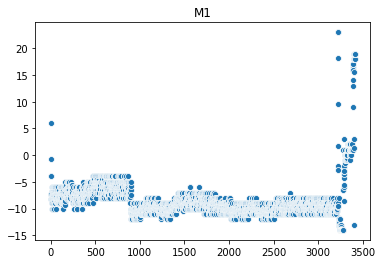

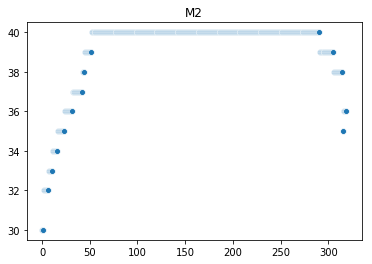

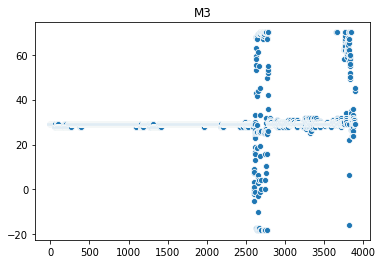

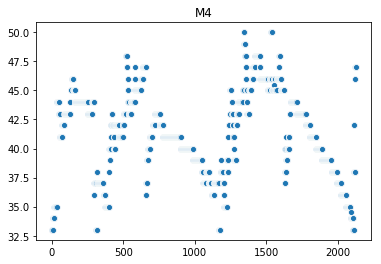

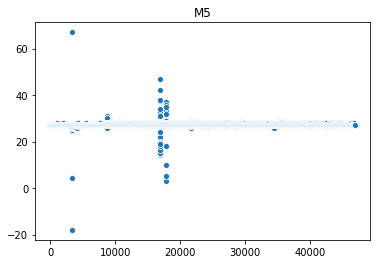

...

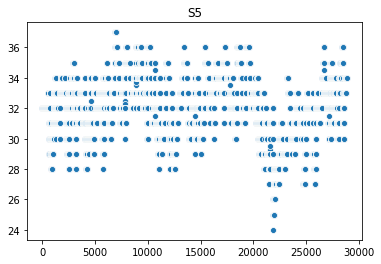

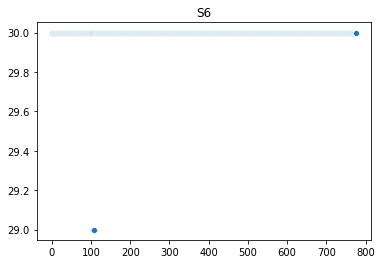

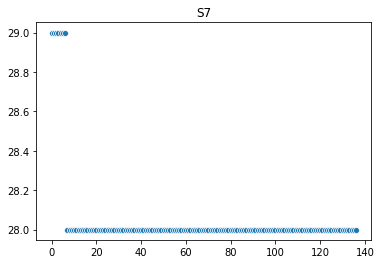

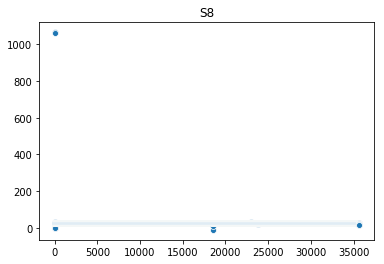

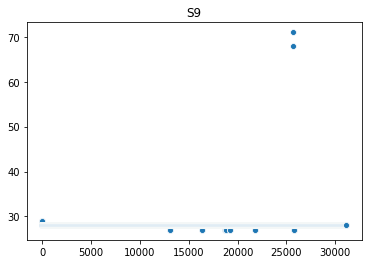

In [133]:
#so2_tmp_clean
for key in data_cleaned.keys():
    plt.figure()
    plt.title(key)
    d = remove_outlier(data_cleaned[key],'uv',0.25,0.75)
#     out = pd.DataFrame(d)
    fin = d[['latitude','longitude','svrtime']].copy()
    fin['so2_tmp'] = remove_outlier_new(d['so2_tmp'].values)
    sns.scatterplot(data = fin['so2_tmp'].values)
#     display(fin.head())
#     fin.reset_index(drop=True).to_csv('./so2_tmp'+key+'.csv')

In [36]:
rest = ['nh3',
 'co',
 'no2',
 'c3h8',
 'c4h10',
 'ch4',
 'h2',
 'c2h5o4',
 'pm01',
 'pm25',
 'pm10',
 'pressure',
 'draft',
 'air_temp',
 'air_speed']

In [37]:
for j in rest:
    for key in data_cleaned.keys():
        d = remove_outlier(data_cleaned[key],j,0.15,0.85)

        fin = d[['latitude','longitude','svrtime']].copy()
        fin[j] = remove_outlier_new(d[j].values)
        if len(fin)>10:
            fin.reset_index(drop=True).to_csv('./'+j+key+'.csv')
        else:
            data_cleaned[key][['latitude','longitude','svrtime',j]].reset_index(drop=True).to_csv('./'+j+key+'.csv')